<a href="https://colab.research.google.com/github/quemariox/Math-e-Science/blob/main/pendulo_duplo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

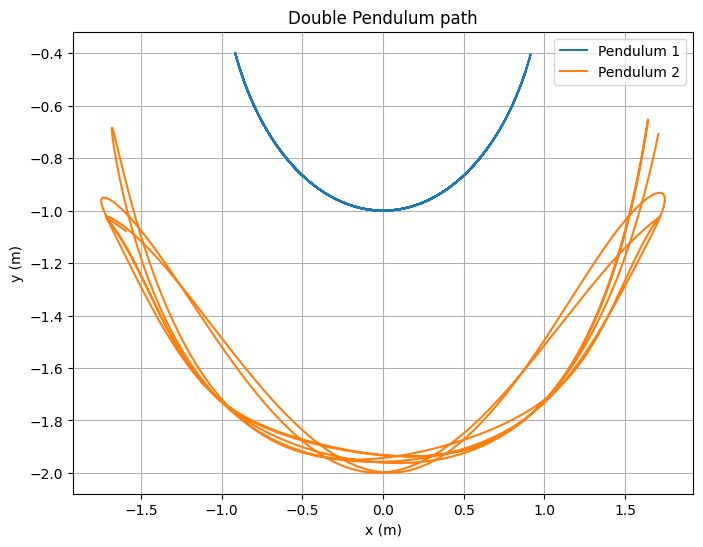

In [2]:
# https://medium.com/@hamxa26/a-dance-of-chaos-simulating-a-double-pendulum-dcbf4f96dd16
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint

# Define the double pendulum equations of motion
def double_pendulum_equations(y, t, L1, L2, m1, m2, g):
    # Unpack the variables from the y array immediately
    theta1, theta1_dot, theta2, theta2_dot = y

    theta1_double_dot = (
        -g * (2 * m1 + m2) * np.sin(theta1) - m2 * g * np.sin(theta1 - 2 * theta2)
        - 2 * np.sin(theta1 - theta2) * m2 * (theta2_dot ** 2 * L2 + theta1_dot ** 2 * L1 * np.cos(theta1 - theta2))
    ) / (L1 * (2 * m1 + m2 - m2 * np.cos(2 * theta1 - 2 * theta2)))

    theta2_double_dot = (
        2 * np.sin(theta1 - theta2) * (theta1_dot ** 2 * L1 * (m1 + m2) + g * (m1 + m2) * np.cos(theta1)
                                      + theta2_dot ** 2 * L2 * m2 * np.cos(theta1 - theta2))
    ) / (L2 * (2 * m1 + m2 - m2 * np.cos(2 * theta1 - 2 * theta2)))

    return [theta1_dot, theta1_double_dot, theta2_dot, theta2_double_dot]

L1 = 1.0  # Length of the first pendulum
L2 = 1.0  # Length of the second pendulum
m1 = 1.0  # Mass of the first pendulum
m2 = 1.0  # Mass of the second pendulum
g = 9.81  # Acceleration due to gravity

y0 = [np.pi / 4, 0, np.pi / 2, 0]

t = np.linspace(0, 10, 1000)

sol = odeint(double_pendulum_equations, y0, t, args=(L1, L2, m1, m2, g))

theta1_sol, theta1_dot_sol, theta2_sol, theta2_dot_sol = sol[:, 0], sol[:, 1], sol[:, 2], sol[:, 3]

x1 = L1 * np.sin(theta1_sol)
y1 = -L1 * np.cos(theta1_sol)
x2 = x1 + L2 * np.sin(theta2_sol)
y2 = y1 - L2 * np.cos(theta2_sol)

plt.figure(figsize=(8, 6))
plt.plot(x1, y1, label='Pendulum 1')
plt.plot(x2, y2, label='Pendulum 2')
plt.xlabel('x (m)')
plt.ylabel('y (m)')
plt.title('Double Pendulum path')
plt.legend()
plt.grid(True)
plt.show()


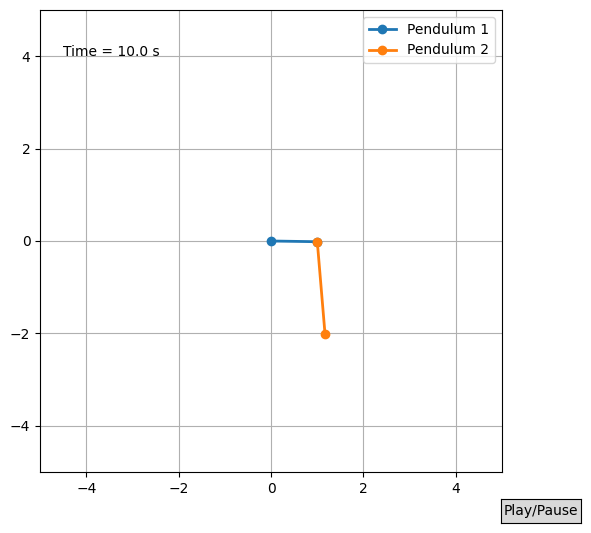

In [14]:
# https://medium.com/@hamxa26/a-dance-of-chaos-simulating-a-double-pendulum-dcbf4f96dd16
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint
from matplotlib.animation import FuncAnimation, PillowWriter
import matplotlib.widgets as widgets

# Define the double pendulum equations of motion
def double_pendulum_equations(y, t, L1, L2, m1, m2, g):
    # Unpack the variables from the y array immediately
    theta1, theta1_dot, theta2, theta2_dot = y

    theta1_double_dot = (
        -g * (2 * m1 + m2) * np.sin(theta1) - m2 * g * np.sin(theta1 - 2 * theta2)
        - 2 * np.sin(theta1 - theta2) * m2 * (theta2_dot ** 2 * L2 + theta1_dot ** 2 * L1 * np.cos(theta1 - theta2))
    ) / (L1 * (2 * m1 + m2 - m2 * np.cos(2 * theta1 - 2 * theta2)))

    theta2_double_dot = (
        2 * np.sin(theta1 - theta2) * (theta1_dot ** 2 * L1 * (m1 + m2) + g * (m1 + m2) * np.cos(theta1)
                                      + theta2_dot ** 2 * L2 * m2 * np.cos(theta1 - theta2))
    ) / (L2 * (2 * m1 + m2 - m2 * np.cos(2 * theta1 - 2 * theta2)))

    return [theta1_dot, theta1_double_dot, theta2_dot, theta2_double_dot]

L1 = 1.0  # Length of the first pendulum
L2 = 2.0  # Length of the second pendulum
m1 = 1.0  # Mass of the first pendulum
m2 = 2.0  # Mass of the second pendulum
g = 9.81  # Acceleration due to gravity

y0 = [np.pi / 4, 0, np.pi / 2, 0]  # Initial conditions

t = np.linspace(0, 10, 1000)  # Time points for simulation

sol = odeint(double_pendulum_equations, y0, t, args=(L1, L2, m1, m2, g))

theta1_sol, theta1_dot_sol, theta2_sol, theta2_dot_sol = sol[:, 0], sol[:, 1], sol[:, 2], sol[:, 3]

x1 = L1 * np.sin(theta1_sol)
y1 = -L1 * np.cos(theta1_sol)
x2 = x1 + L2 * np.sin(theta2_sol)
y2 = y1 - L2 * np.cos(theta2_sol)

# Set up the figure and axes for animation
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, autoscale_on=False, xlim=(-5, 5), ylim=(-5, 5))
ax.set_aspect('equal')
ax.grid()

line1, = ax.plot([], [], 'o-', lw=2, label='Pendulum 1')
line2, = ax.plot([], [], 'o-', lw=2, label='Pendulum 2')
time_text = ax.text(0.05, 0.9, '', transform=ax.transAxes)
ax.legend()

# Animation function to update the plot for each frame
def animate(i):
    line1.set_data([0, x1[i]], [0, y1[i]])
    line2.set_data([x1[i], x2[i]], [y1[i], y2[i]])
    time_text.set_text(f'Time = {t[i]:.1f} s')
    return line1, line2, time_text

# Criar a animação (inicialmente pausada)
ani = FuncAnimation(fig, animate, frames=len(t), interval=20, blit=True, repeat=False)

# Função para iniciar/pausar a animação
def toggle_animation(event):
    global ani
    if ani._running:
        ani.event_source.stop()
    else:
        ani.event_source.start()

# Adicionar um botão para iniciar/pausar
button_ax = plt.axes([0.8, 0.025, 0.1, 0.04])
button = widgets.Button(button_ax, 'Play/Pause')
button.on_clicked(toggle_animation)

# Exibir a animação no Colab
from IPython.display import HTML
HTML(ani.to_jshtml())